In [52]:
%matplotlib inline
import torch
import torch.nn as nn
import torchvision.models as models
import numpy as np
import matplotlib.pyplot as plt
import PIL
from torchsummary import summary
from collections import OrderedDict
import torchvision.transforms as transforms

In [53]:
from torch import nn
class AlexnetDeconv(nn.Module):
    
    def __init__(self):
        super(AlexnetDeconv, self).__init__()
        

        self.features = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=11, stride=4, padding=2),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2, padding=0, return_indices=True),
            nn.Conv2d(64, 192, kernel_size=5, stride=1, padding=2),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2, padding=0, return_indices=True),
            nn.Conv2d(192, 384, kernel_size=3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(384, 256, kernel_size=3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2, padding=0, return_indices=True)
        )
        self.avgpool = nn.AdaptiveAvgPool2d(output_size=(6, 6))
        self.classifier = nn.Sequential(
            nn.Dropout(p=0.5, inplace=False),
            nn.Linear(in_features=9216, out_features=4096, bias=True),
            nn.ReLU(inplace=True),
            nn.Dropout(p=0.5, inplace=False),
            nn.Linear(in_features=4096, out_features=4096, bias=True),
            nn.ReLU(inplace=True),
            nn.Linear(in_features=4096, out_features=1000, bias=True)
        )
        self.deconv = nn.Sequential(
            nn.MaxUnpool2d(kernel_size=3, stride=2, padding=0),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(256, 256, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(256, 384, kernel_size=3, stride=1, padding=1, bias=False),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(384, 192, kernel_size=3, stride=1, padding=1, bias=False),
            nn.MaxUnpool2d(kernel_size=3, stride=2, padding=0),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(192, 64, kernel_size=5, stride=1, padding=2, bias=False),
            nn.MaxUnpool2d(kernel_size=3, stride=2, padding=0),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(64, 3, kernel_size=11, stride=4, padding=2, bias=False),
        )
        
        self.outputs = [0]*len(self.features)
        self.indices = dict()
        self.sizes = dict()

    def forward(self, x):
        for i, layer in enumerate(self.features):
            if isinstance(layer, nn.MaxPool2d):
                x, indices = layer(x)
                self.outputs[i] = x
                self.indices[i] = indices
            else:
                x = layer(x)
                self.outputs[i] = x
        x = self.avgpool(x)
        x = x.view(x.size(0), -1)
        x = self.classifier(x)
        return x
    
    def deconv_forward(self, x, layer):

        if layer<1 or layer >5:
            return False

        if layer == 5:
            x = self.deconv[0](x, self.indices[12], output_size=self.outputs[-2].shape[-2:])
            x = self.deconv[1](x)
            x = self.deconv[2](x)
            layer-=1
      
        if layer == 4:
            x = self.deconv[3](x)
            x = self.deconv[4](x)
            layer-=1
        
        if layer == 3:
            x = self.deconv[5](x)
            x = self.deconv[6](x)
            layer-=1
        
        if layer == 2:
            x = self.deconv[7](x, self.indices[5], output_size=self.outputs[4].shape[-2:])
            x = self.deconv[8](x)
            x = self.deconv[9](x)
            layer-=1
     
        if layer == 1:
            x = self.deconv[10](x, self.indices[2], output_size=self.outputs[1].shape[-2:])
            x = self.deconv[11](x)
            x = self.deconv[12](x)

        return x
        


In [54]:
model = AlexnetDeconv()
print(model.state_dict().keys())

odict_keys(['features.0.weight', 'features.0.bias', 'features.3.weight', 'features.3.bias', 'features.6.weight', 'features.6.bias', 'features.8.weight', 'features.8.bias', 'features.10.weight', 'features.10.bias', 'classifier.1.weight', 'classifier.1.bias', 'classifier.4.weight', 'classifier.4.bias', 'classifier.6.weight', 'classifier.6.bias', 'deconv.2.weight', 'deconv.4.weight', 'deconv.6.weight', 'deconv.9.weight', 'deconv.12.weight'])


In [55]:
import torchvision.models as models
alexnet = models.alexnet(pretrained=True)
alexnet_weights = alexnet.state_dict()
print(alexnet_weights.keys())

odict_keys(['features.0.weight', 'features.0.bias', 'features.3.weight', 'features.3.bias', 'features.6.weight', 'features.6.bias', 'features.8.weight', 'features.8.bias', 'features.10.weight', 'features.10.bias', 'classifier.1.weight', 'classifier.1.bias', 'classifier.4.weight', 'classifier.4.bias', 'classifier.6.weight', 'classifier.6.bias'])


In [56]:
def set_ith_filters(filters, ith):
    x=filters.detach().clone()
    n, m = x.shape[1:3]
    zero_filter = torch.tensor([[[0]*m]*m]*n)
    for i in range(0, x.shape[0]):
        if i != ith:
            x[i]=zero_filter
    return x

In [57]:
def set_weights(modified_layer = -1, filter = None):
    new_dict = dict()
    for key in alexnet_weights.keys():
        if key in model.state_dict().keys():
            new_dict[key] = alexnet_weights[key]

    deconvs = ['deconv.2.weight', 'deconv.4.weight', 'deconv.6.weight', 'deconv.9.weight', 'deconv.12.weight']
    convs = ['features.10.weight', 'features.8.weight', 'features.6.weight', 'features.3.weight', 'features.0.weight']

    for i in range(0, 5):
        if 5 - modified_layer == i:
            new_dict[deconvs[i]] = set_ith_filters(alexnet_weights[convs[i]], filter)
        else:
            new_dict[deconvs[i]] = alexnet_weights[convs[i]]
    model_dict = model.state_dict()
    model_dict.update(new_dict)
    model.load_state_dict(model_dict)
    return
    
set_weights()


In [58]:
from PIL import Image

def image_preprocess(image):
    normalize = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    image = normalize(image).unsqueeze(0)
    return image

In [59]:
def adjust(inp):
    if torch.is_tensor(inp):
        inp = inp.numpy()
    inp = (inp-np.min(inp))/(np.max(inp)-np.min(inp)+1e-10)
    inp*=255
    inp= inp.astype(int)
    return inp

In [60]:
p1 = Image.open('1.jpeg')
p2 = Image.open('2.jpeg')
p3 = Image.open('4.jpeg')
p4 = Image.open('kids.jpg')
p5 = Image.open('5.jpeg')
p5 = adjust(image_preprocess(p5))
images = [adjust(image_preprocess(img)) for img in [p1, p2, p3, p4]]

In [61]:
outputs_ = []
indices_ = []
indices = [2, 5, 7, 9, 12]
vizz = []

for image in [p5]:
    output = model(torch.tensor(image.astype('float32')))
    layer_viz = []
    for ind, i in enumerate(indices):
        for_all_filters = []
        for j in range(0, 64):
            set_weights(modified_layer=ind+1, filter = j)
            res = model.deconv_forward(model.outputs[i], ind+1).detach().numpy()
            for_all_filters.append(res)
        layer_viz.append(for_all_filters)
    vizz.append(layer_viz)

In [62]:
def plot_grid(images):
    fig, axs = plt.subplots(8, 8, figsize=(14, 14))

    # flatten the axs array to make it easier to iterate over
    axs = axs.flatten()

    # loop over the images and plot them in the subplots
    for i, img in enumerate(images):
        axs[i].imshow(adjust(np.transpose(img[0], (1,2,0))))
        axs[i].axis('off')

    # adjust the subplot layout and display the plot
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

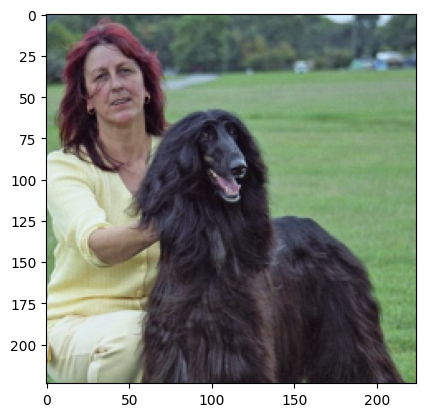

layer 1 first 64 filters


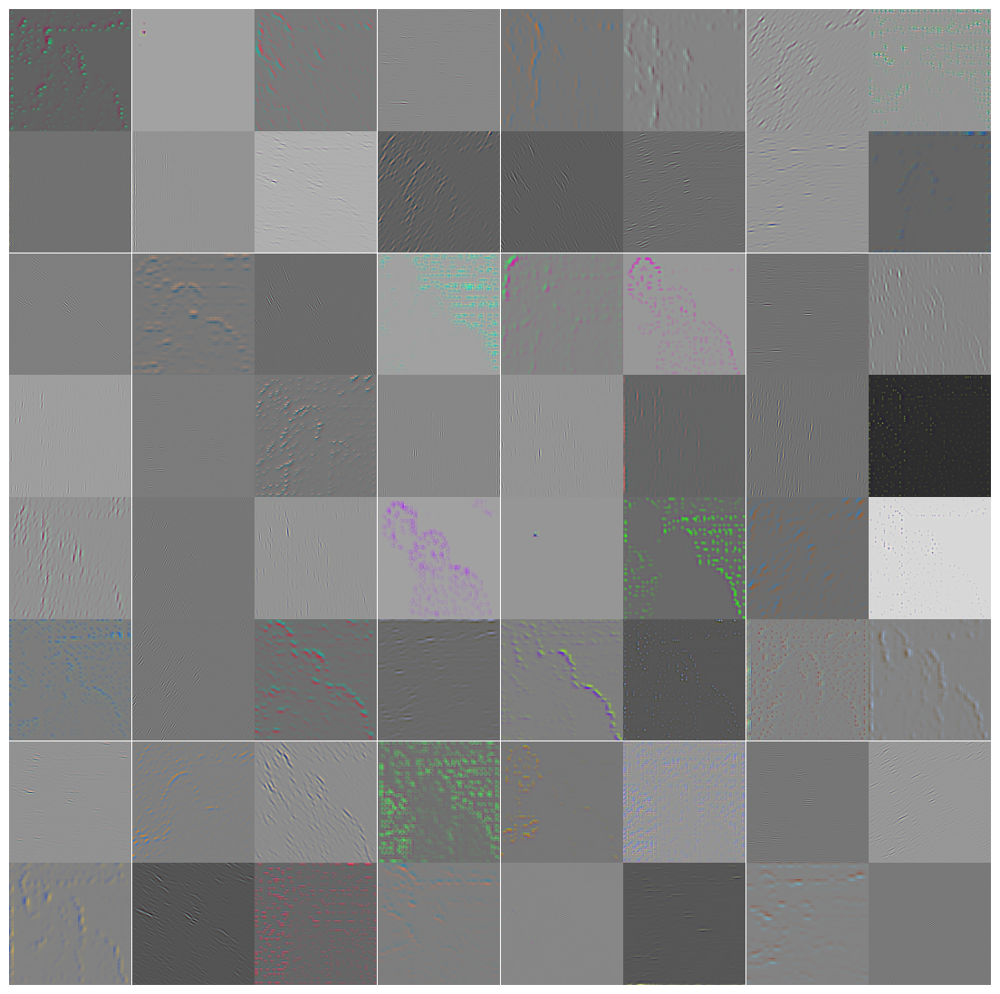

layer 2 first 64 filters


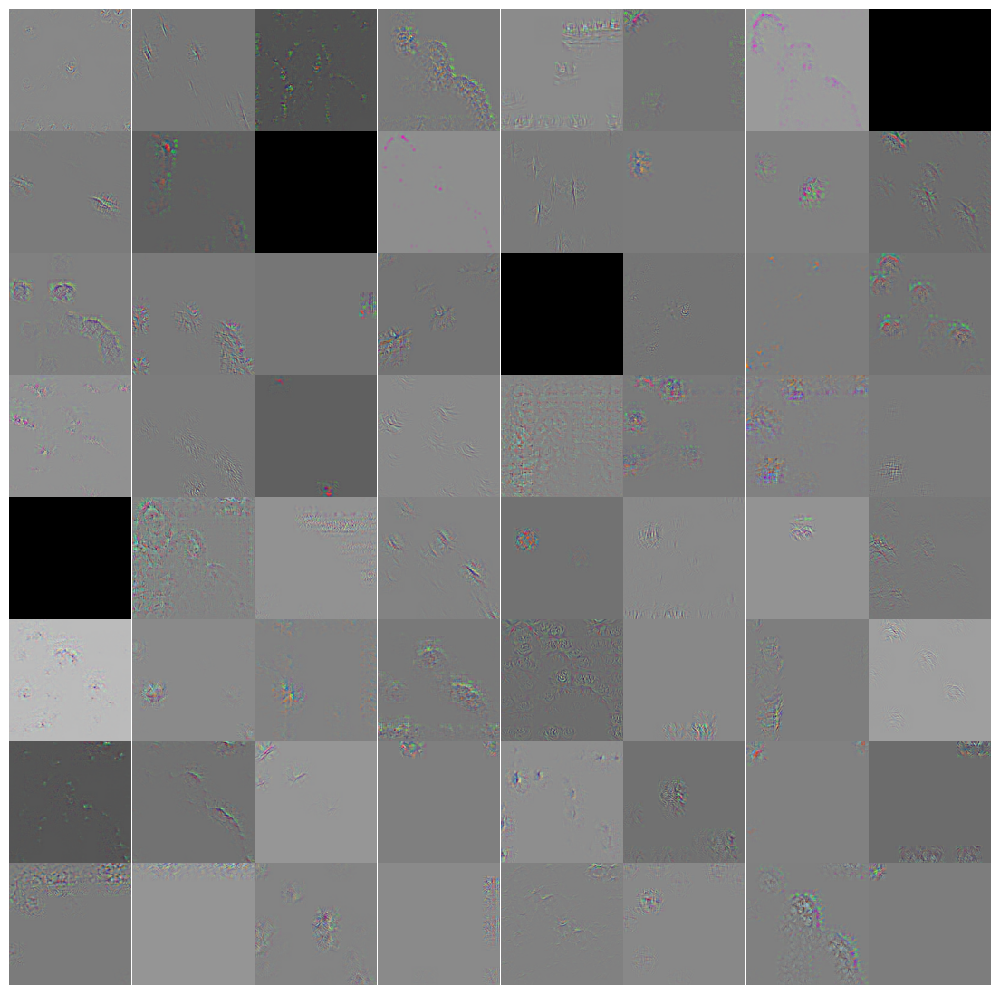

layer 3 first 64 filters


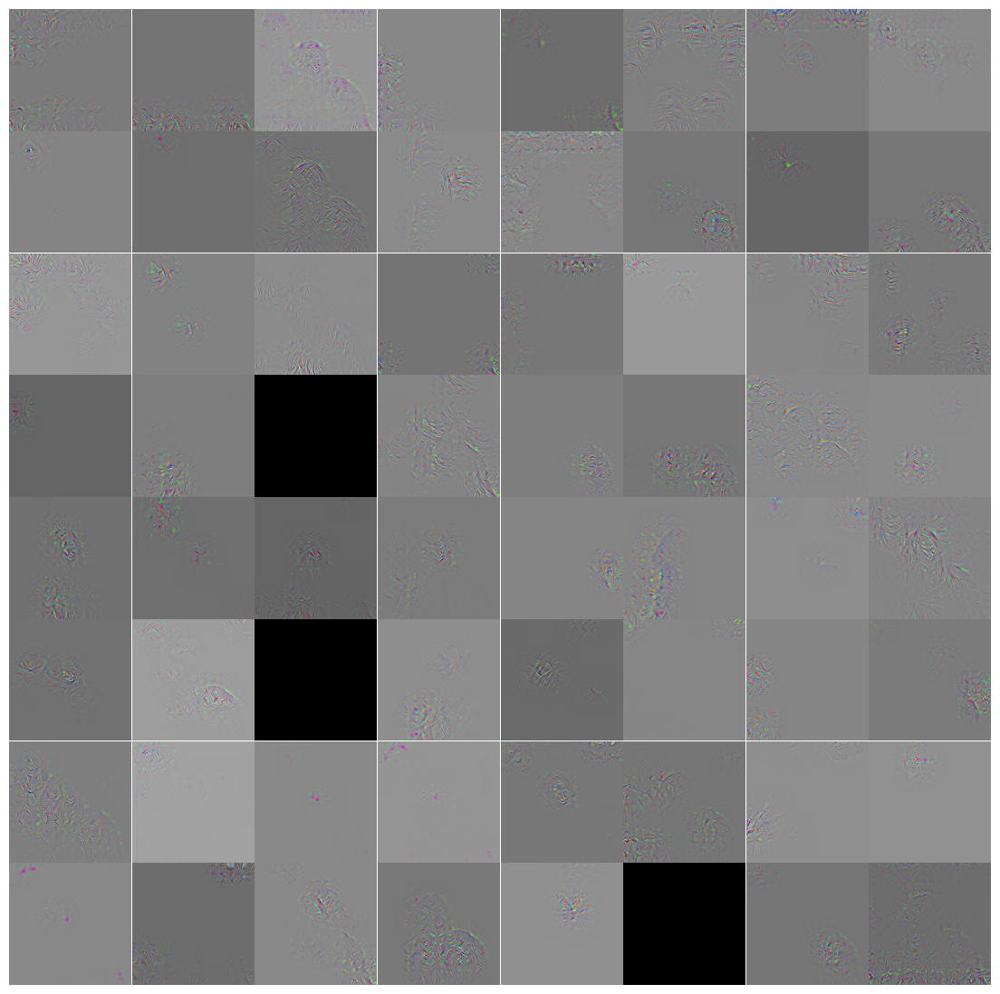

layer 4 first 64 filters


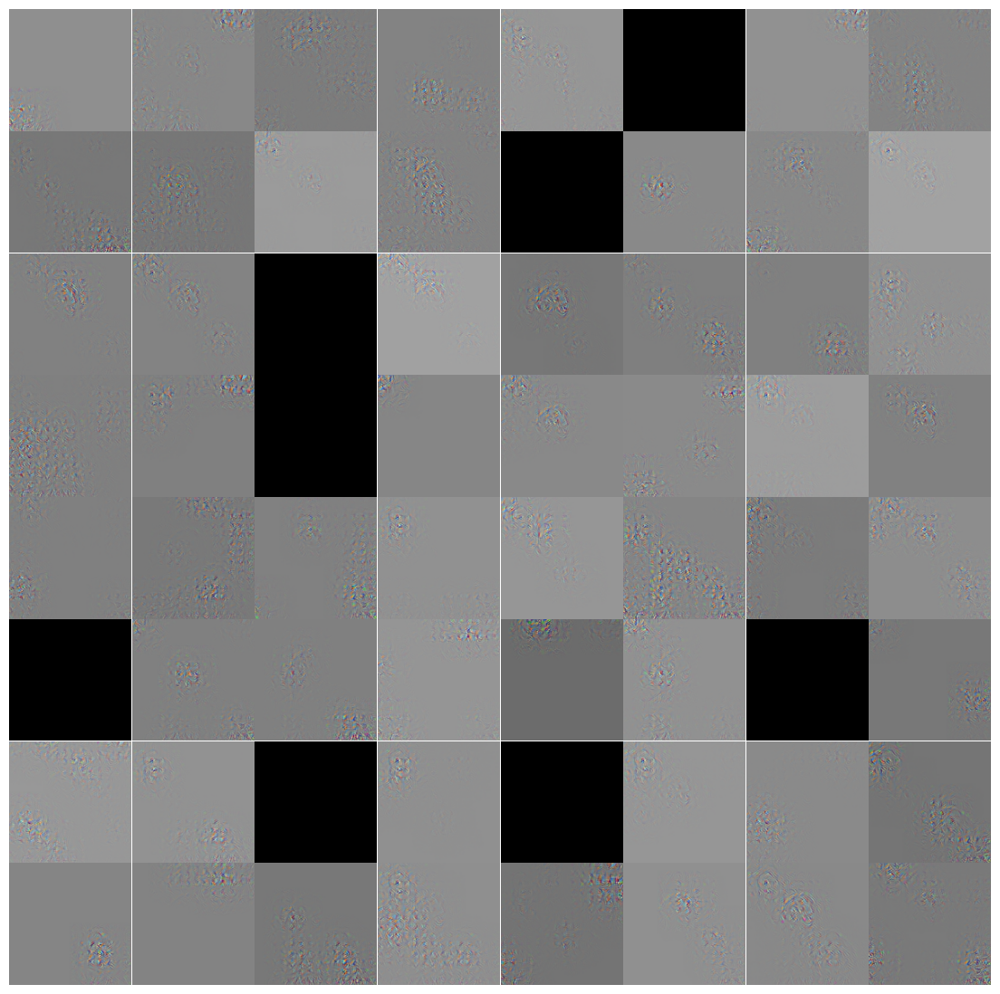

layer 5 first 64 filters


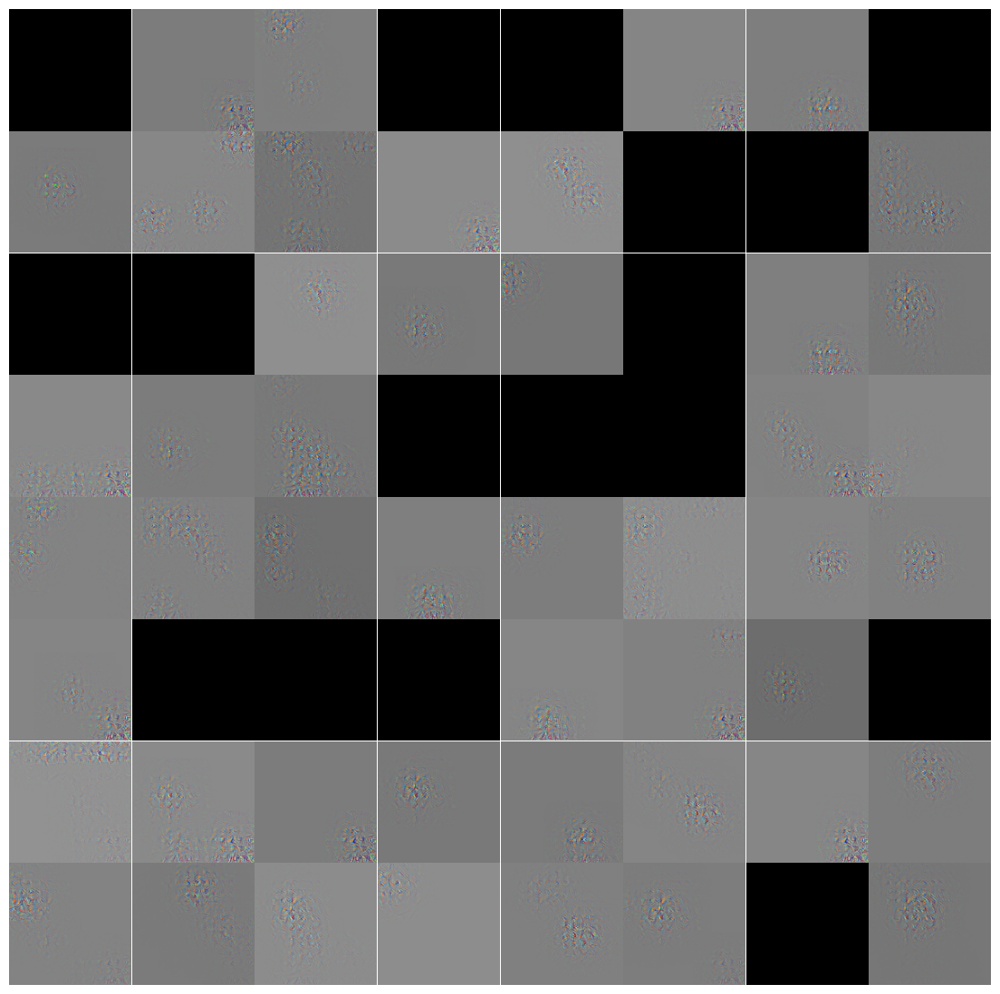

In [63]:
plt.imshow(adjust(np.asarray(np.transpose(p5[0], (1, 2, 0)))))
plt.show()
for i, layer in enumerate(vizz[0]):
    print(f"layer {i+1} first 64 filters")
    plot_grid(layer)

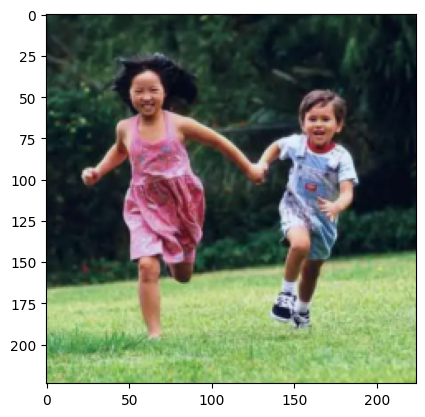

layer 1 first 64 filters


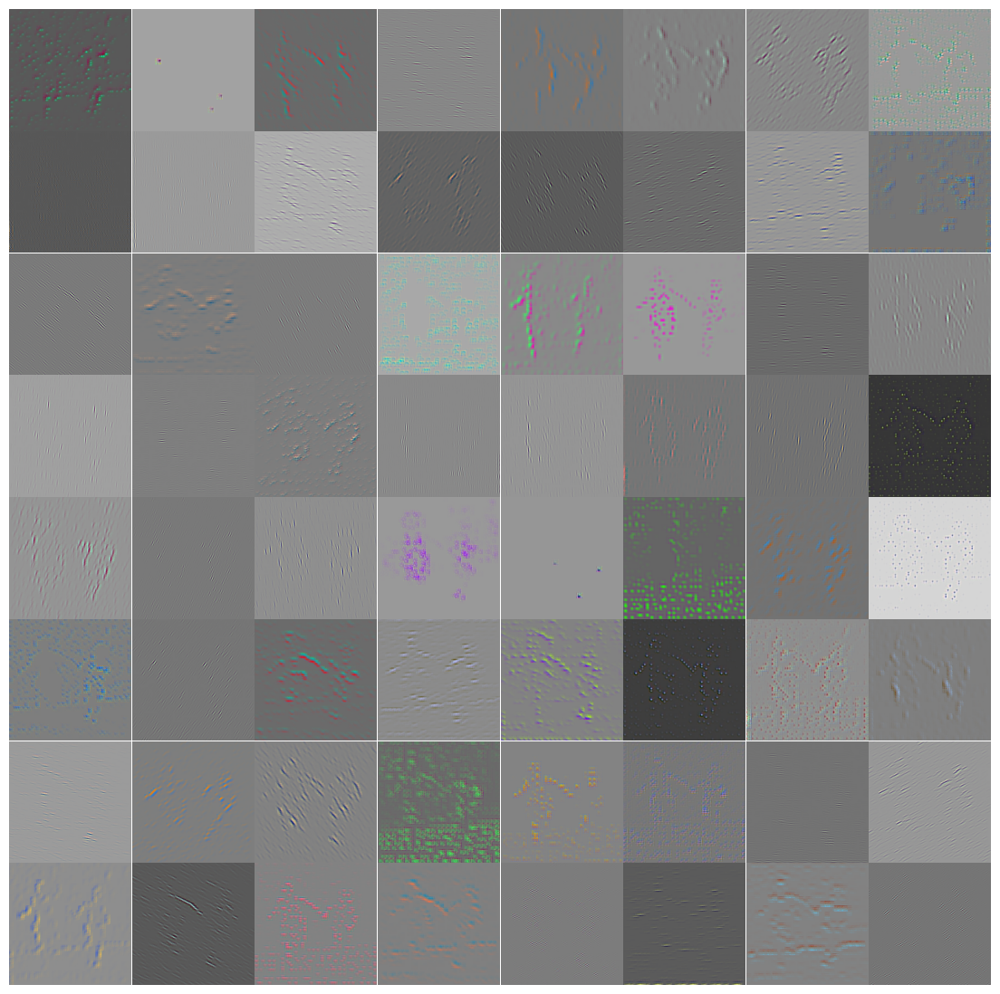

layer 2 first 64 filters


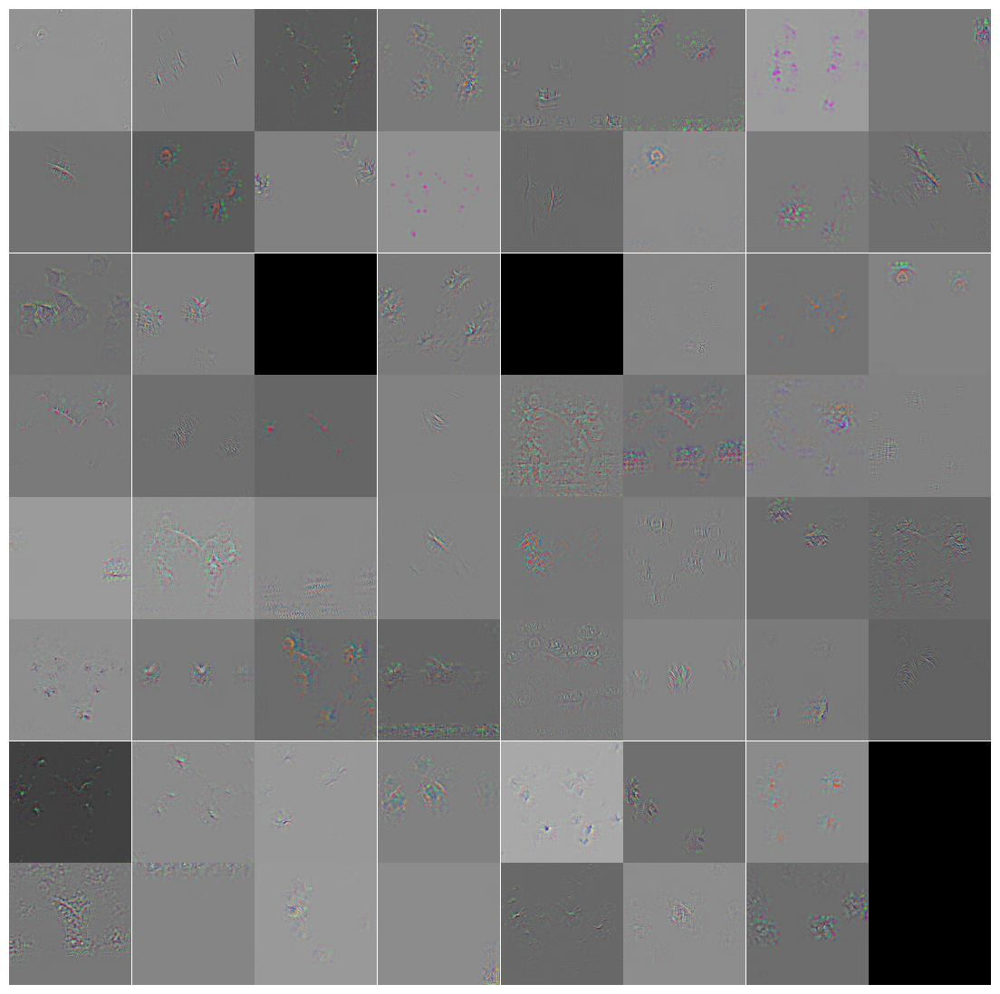

layer 3 first 64 filters


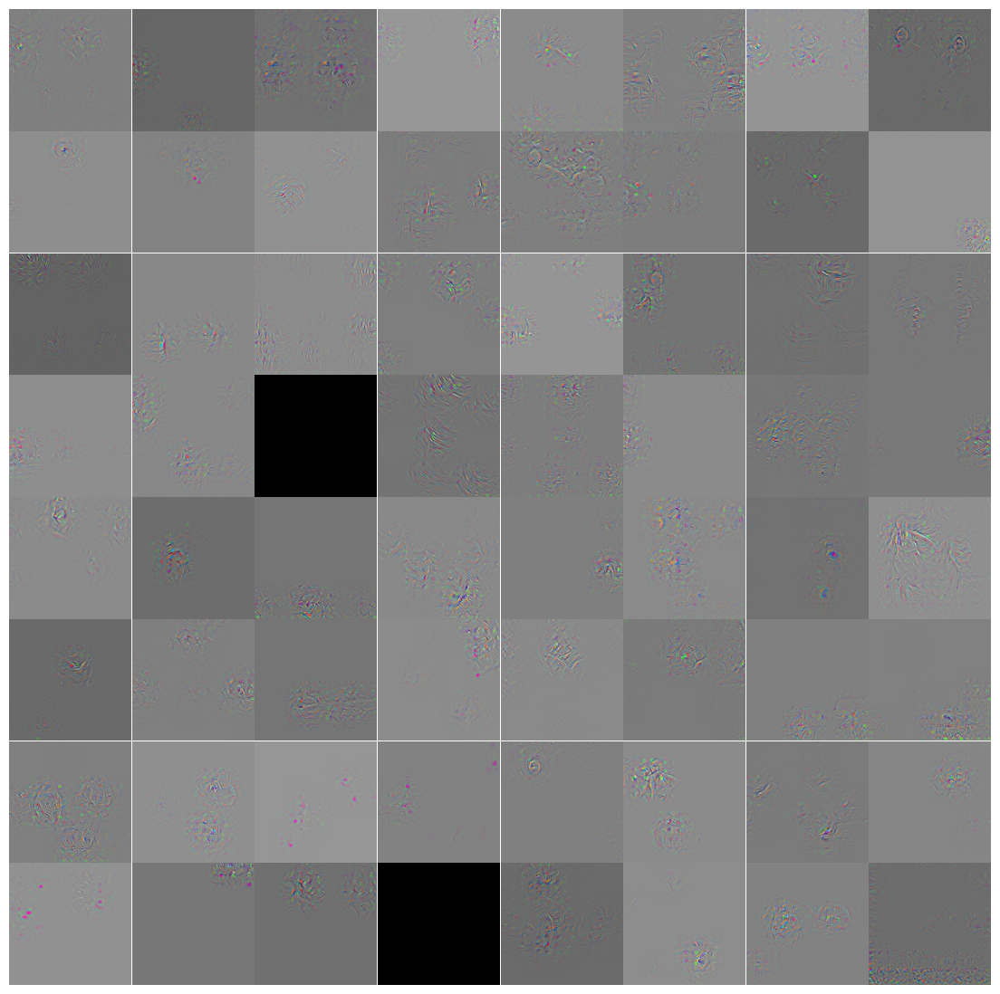

layer 4 first 64 filters


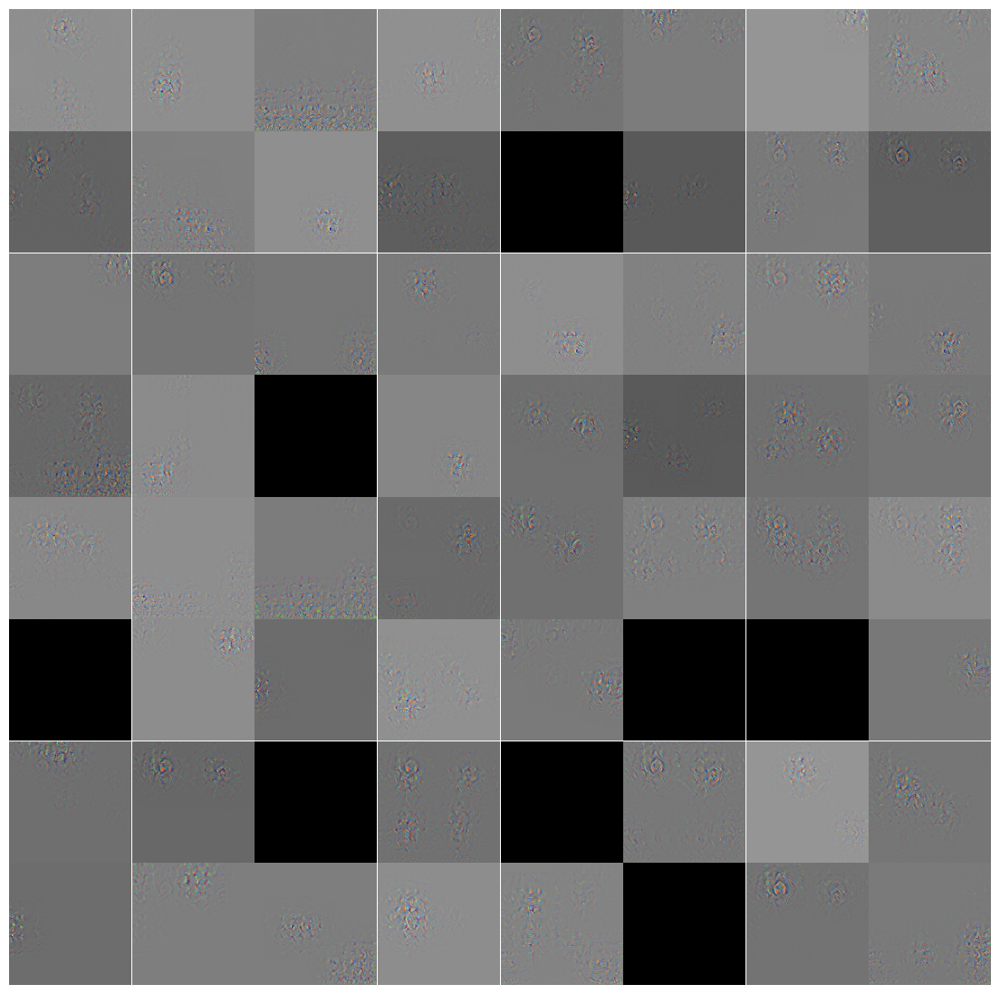

layer 5 first 64 filters


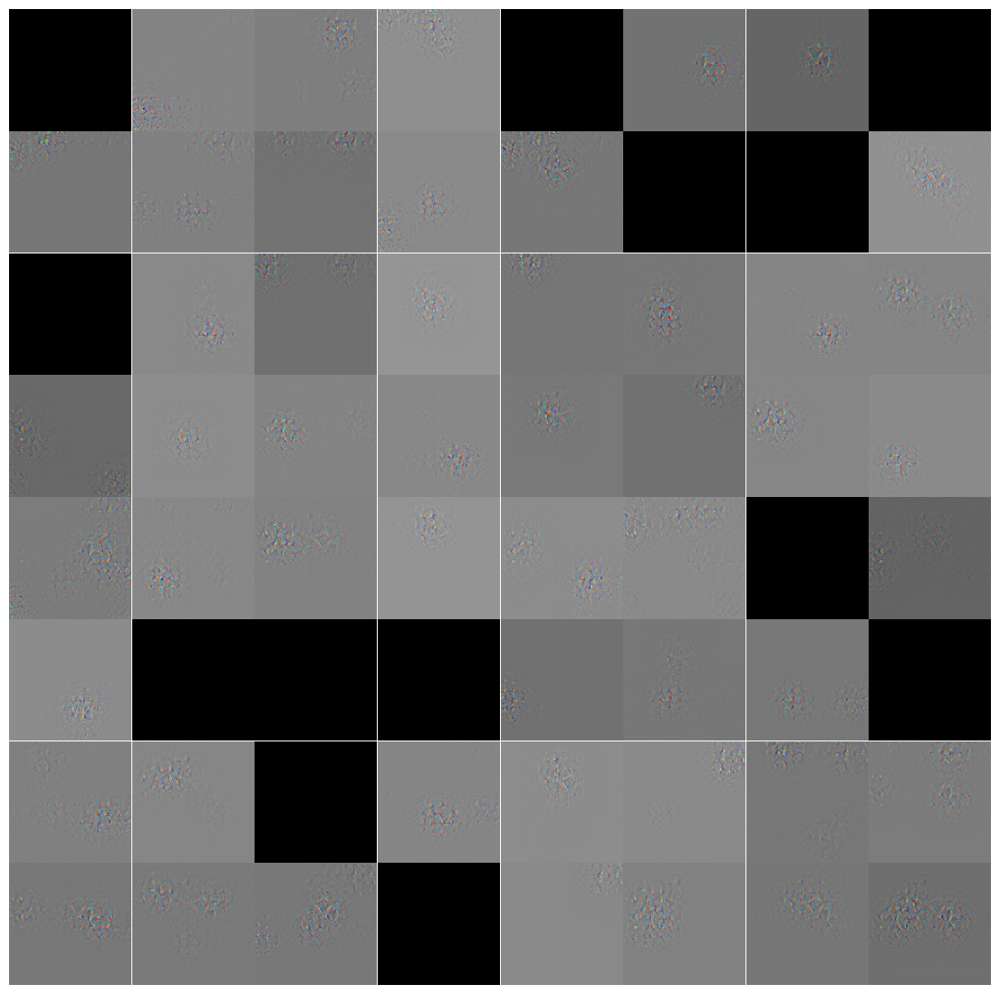

In [65]:
outputs_ = []
indices_ = []
indices = [2, 5, 7, 9, 12]
vizz = []

for image in [images[3]]:
    output = model(torch.tensor(image.astype('float32')))
    layer_viz = []
    for ind, i in enumerate(indices):
        for_all_filters = []
        for j in range(0, 64):
            set_weights(modified_layer=ind+1, filter = j)
            res = model.deconv_forward(model.outputs[i], ind+1).detach().numpy()
            for_all_filters.append(res)
        layer_viz.append(for_all_filters)
    vizz.append(layer_viz)
    
plt.imshow(adjust(np.asarray(np.transpose(images[3][0], (1, 2, 0)))))
plt.show()

for i, layer in enumerate(vizz[0]):
    print(f"layer {i+1} first 64 filters")
    plot_grid(layer)

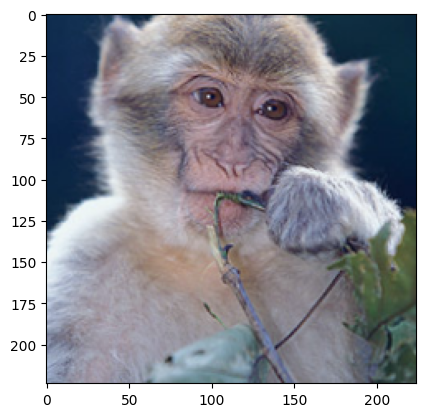

layer 1 first 64 filters


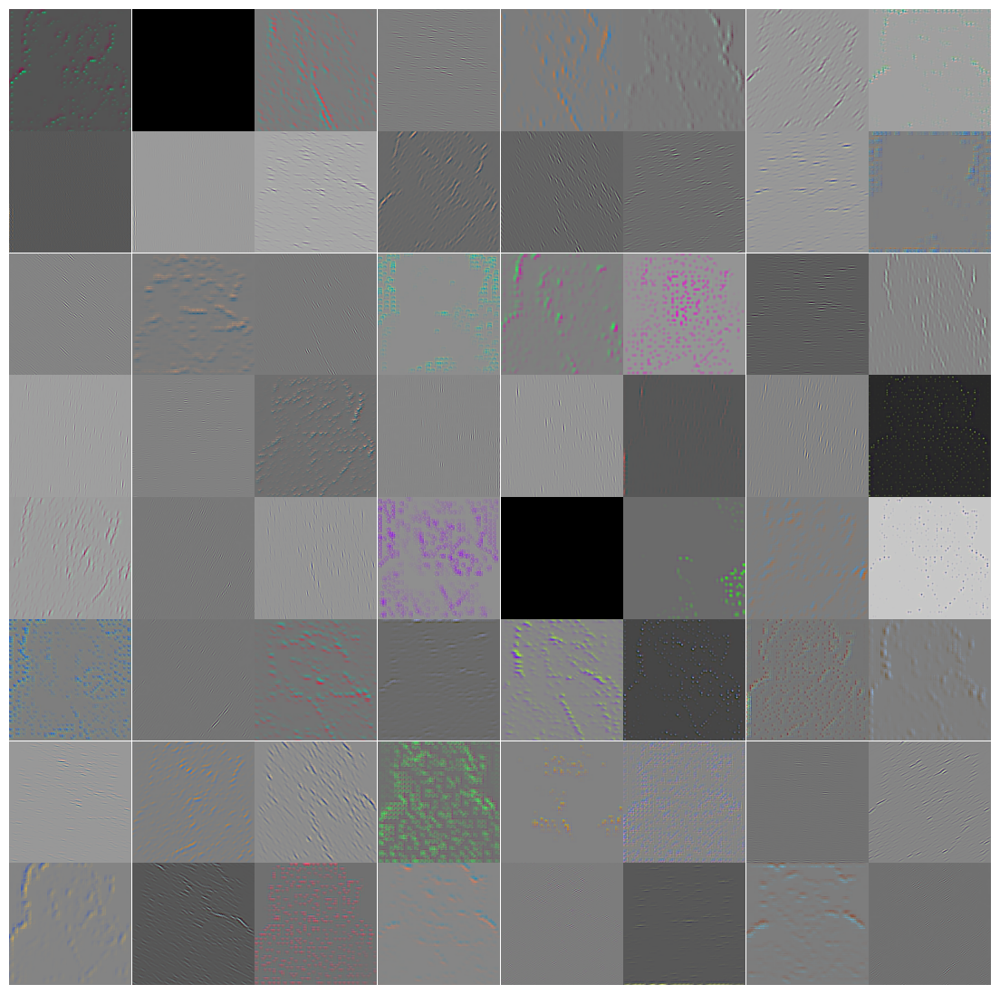

layer 2 first 64 filters


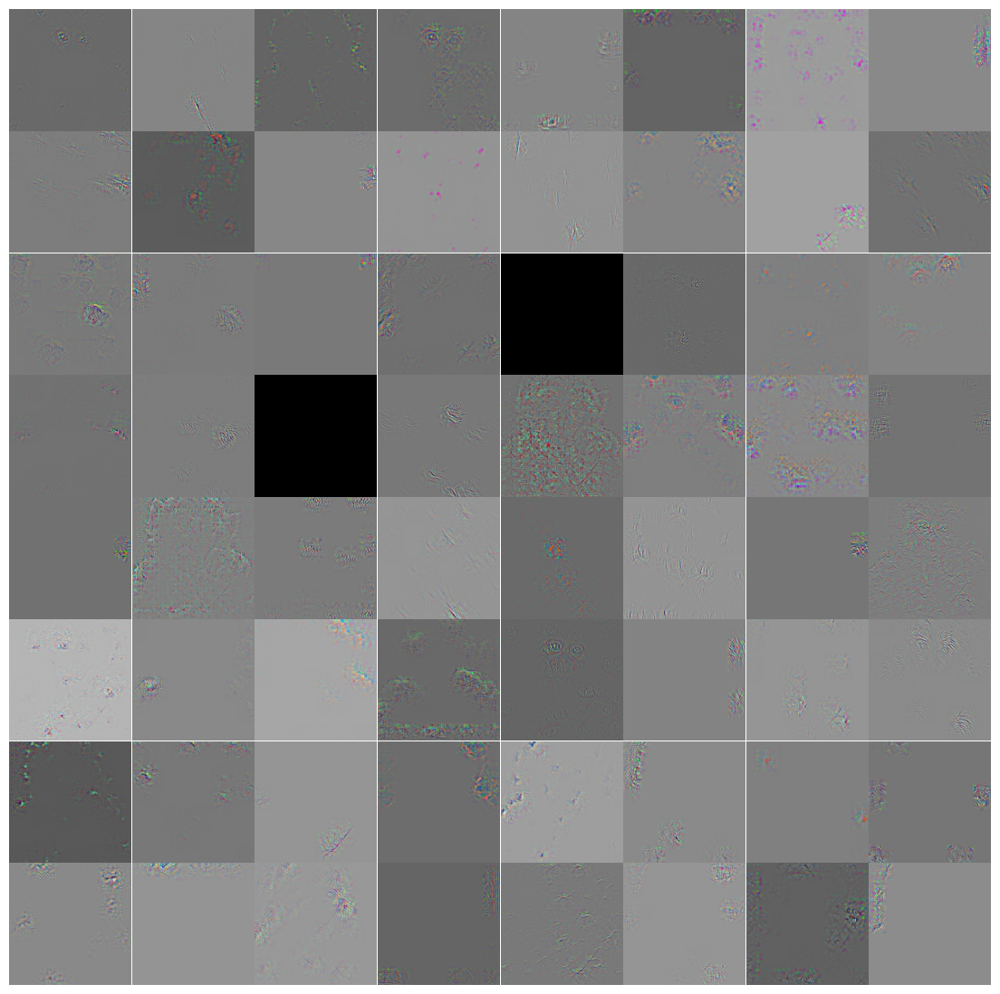

layer 3 first 64 filters


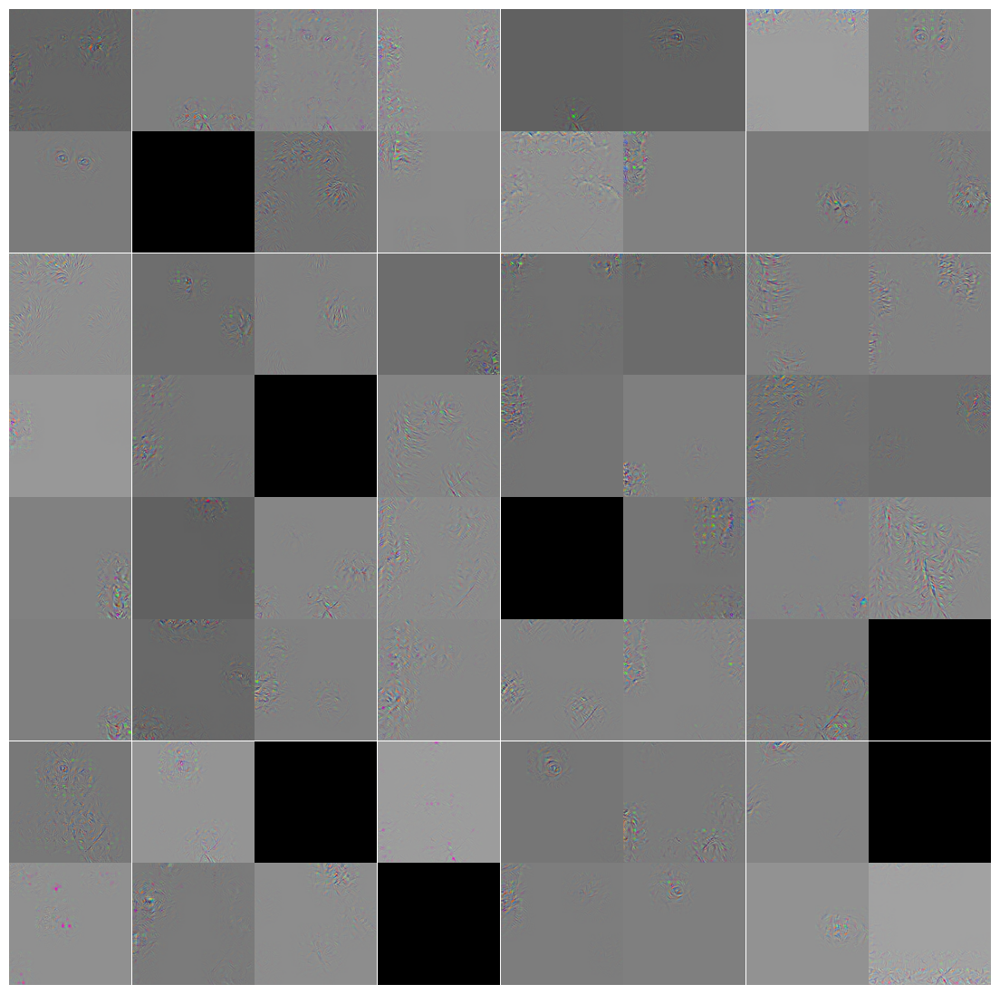

layer 4 first 64 filters


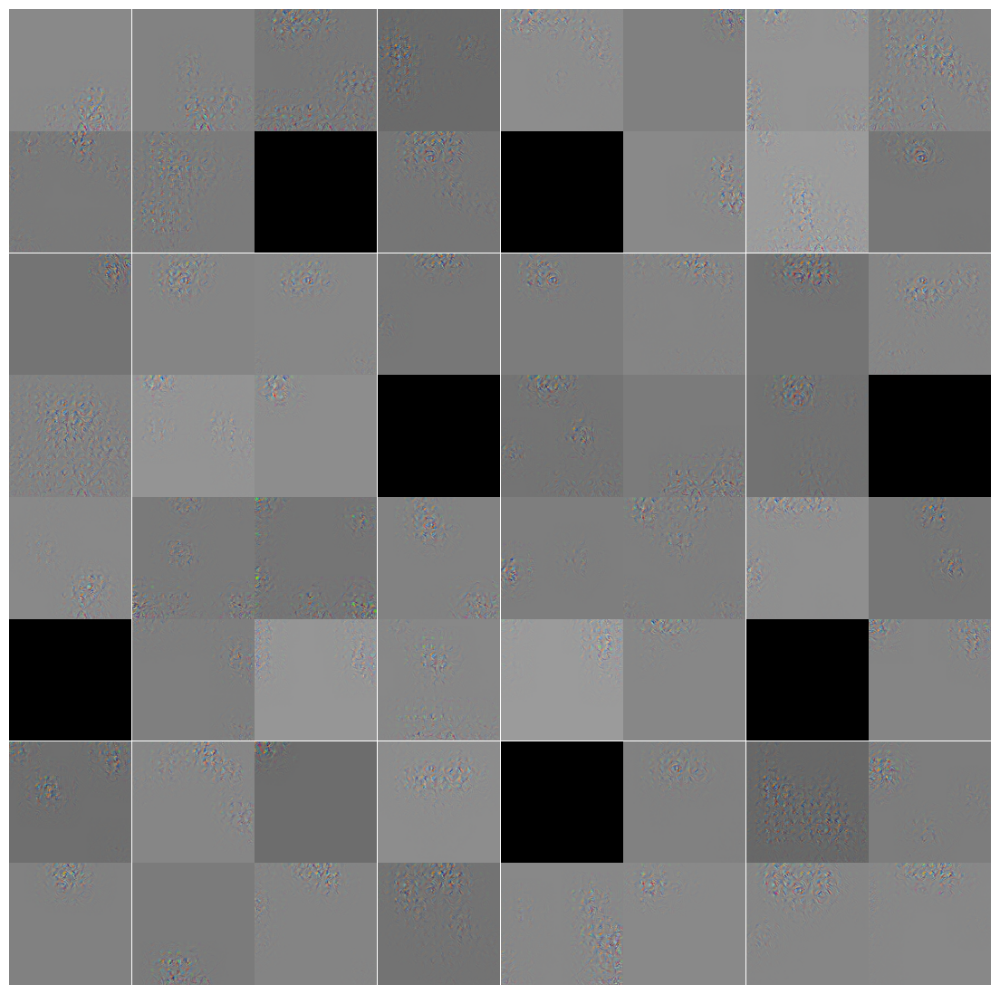

layer 5 first 64 filters


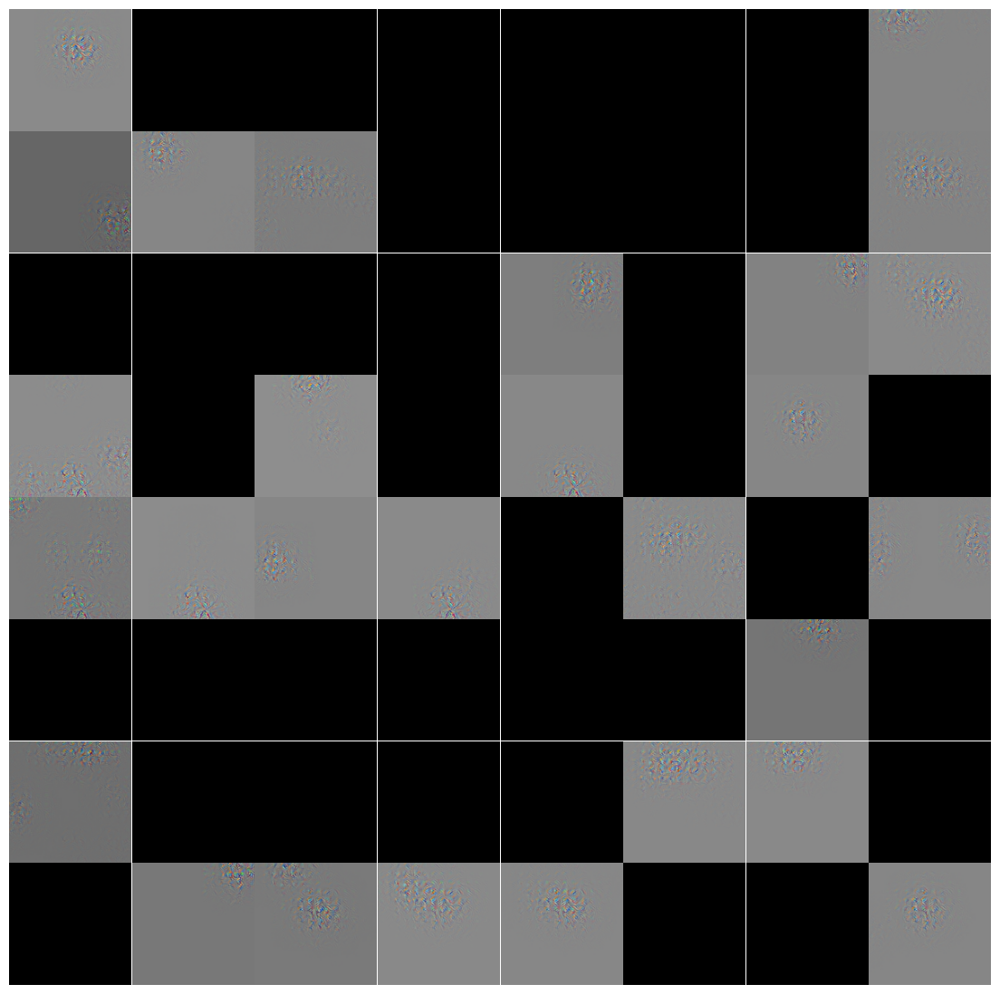

In [66]:
outputs_ = []
indices_ = []
indices = [2, 5, 7, 9, 12]
vizz = []

for image in [images[2]]:
    output = model(torch.tensor(image.astype('float32')))
    layer_viz = []
    for ind, i in enumerate(indices):
        for_all_filters = []
        for j in range(0, 64):
            set_weights(modified_layer=ind+1, filter = j)
            res = model.deconv_forward(model.outputs[i], ind+1).detach().numpy()
            for_all_filters.append(res)
        layer_viz.append(for_all_filters)
    vizz.append(layer_viz)
    
plt.imshow(adjust(np.asarray(np.transpose(images[2][0], (1, 2, 0)))))
plt.show()

for i, layer in enumerate(vizz[0]):
    print(f"layer {i+1} first 64 filters")
    plot_grid(layer)